In [1]:
from diffusers import StableDiffusionPipeline, UNet2DConditionModel, StableDiffusionXLPipeline
import torch
torch.set_grad_enabled(False)

In [3]:
dpo_unet = UNet2DConditionModel.from_pretrained(
                            'mhdang/dpo-sd1.5-text2image-v1',
                            # 'mhdang/dpo-sdxl-text2image-v1',
                            # alternatively use local ckptdir (*/checkpoint-n/)
                            subfolder='unet',
                            torch_dtype=torch.float16
).to('cuda')

unet/config.json:   0%|          | 0.00/1.77k [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

In [4]:
# pretrained_model_name = "CompVis/stable-diffusion-v1-4"
pretrained_model_name = "runwayml/stable-diffusion-v1-5"
# pretrained_model_name = "stabilityai/stable-diffusion-xl-base-1.0"
gs = (5 if 'stable-diffusion-xl' in pretrained_model_name else 7.5)

In [5]:
if 'stable-diffusion-xl' in pretrained_model_name:
    pipe = StableDiffusionXLPipeline.from_pretrained(
        pretrained_model_name, torch_dtype=torch.float16,
        variant="fp16", use_safetensors=True
    ).to("cuda")
else:
    pipe = StableDiffusionPipeline.from_pretrained(pretrained_model_name,
                                                   torch_dtype=torch.float16)
pipe = pipe.to('cuda')
pipe.safety_checker = None # Trigger-happy, blacks out >50% of "robot tiger"



Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


In [6]:
# Can do clip_utils, aes_utils, hps_utils
from utils.pickscore_utils import Selector
# Score generations automatically w/ reward model
ps_selector = Selector('cuda')

preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/904 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.72k [00:00<?, ?B/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.51k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/3.94G [00:00<?, ?B/s]

In [7]:
unets = [pipe.unet, dpo_unet]
names = ["Orig. SDXL", "DPO SDXL"]
names = ["Orig. SD-1.5", "DPO SD-1.5"]

In [8]:
def gen(prompt, seed=0, run_baseline=True):
    ims = []
    generator = torch.Generator(device='cuda')
    for unet_i in ([0, 1] if run_baseline else [1]):
        print(f"Prompt: {prompt}\nSeed: {seed}\n{names[unet_i]}")
        pipe.unet = unets[unet_i]
        generator = generator.manual_seed(seed)
        
        im = pipe(prompt=prompt, generator=generator, guidance_scale=gs).images[0]
        display(im)
        ims.append(im)
    return ims

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

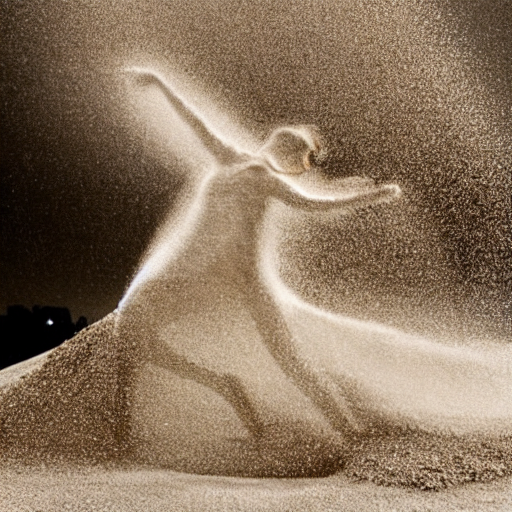

Prompt: A pile of sand swirling in the wind forming the shape of a dancer
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

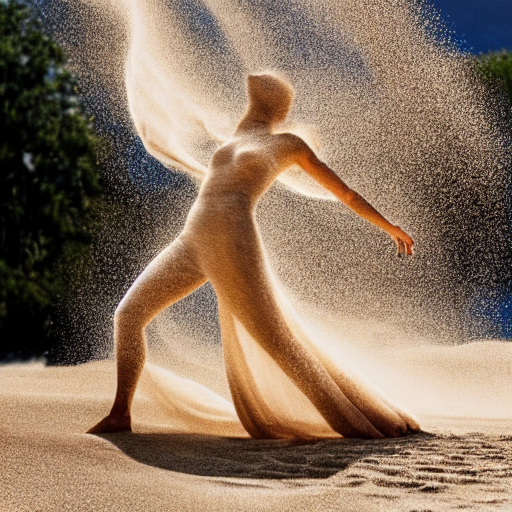

[0.2309865951538086, 0.23477604985237122]
Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

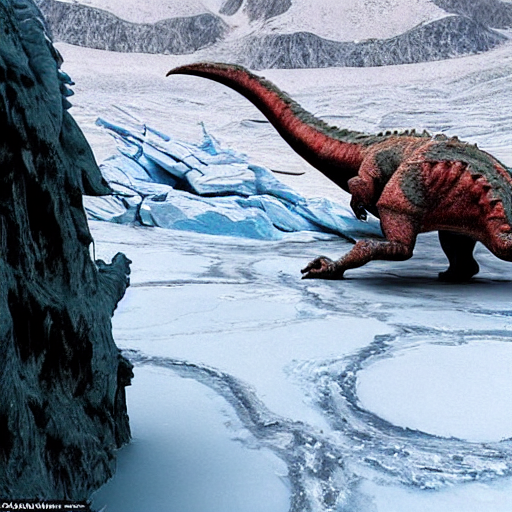

Prompt: A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

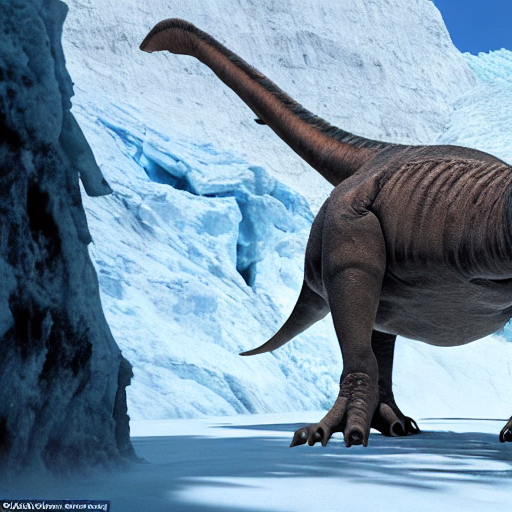

[0.20143243670463562, 0.19793586432933807]
Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

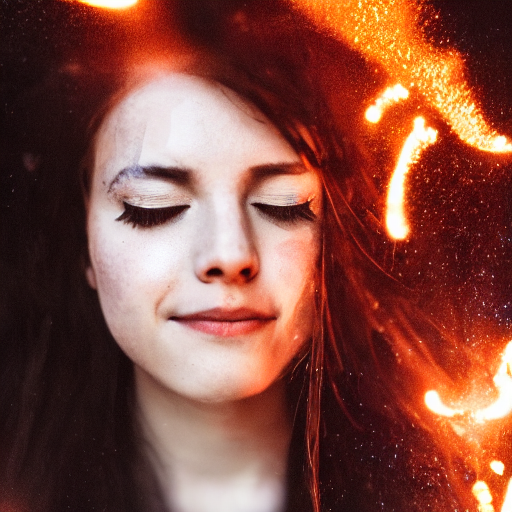

Prompt: a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

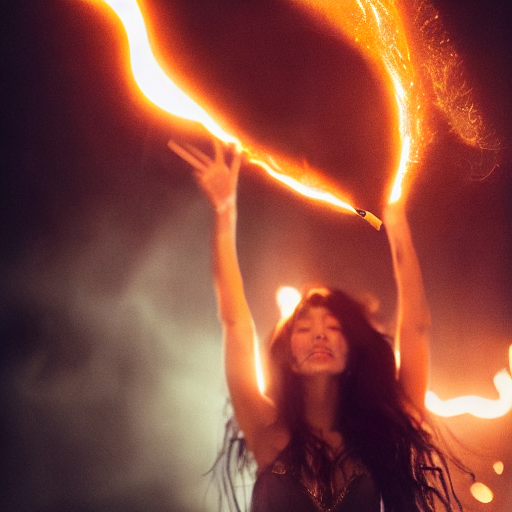

[0.2016664296388626, 0.18418672680854797]
Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

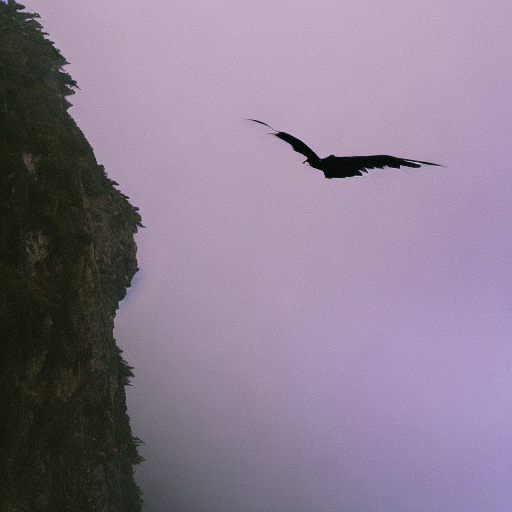

Prompt: A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

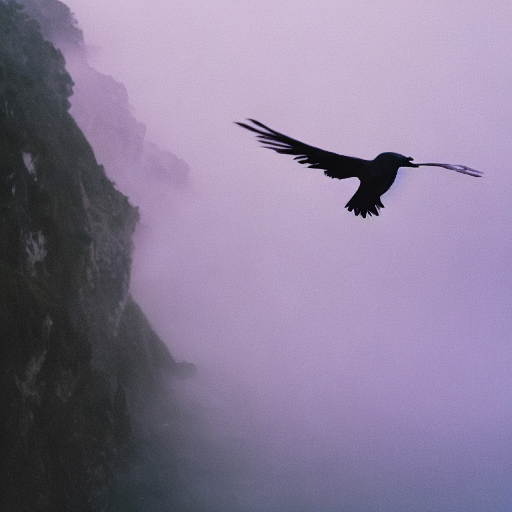

[0.18659117817878723, 0.20124027132987976]
Prompt: a smiling beautiful sorceress wearing a modest high necked blue suit surrounded by swirling rainbow aurora, hyper-realistic, cinematic, post-production
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

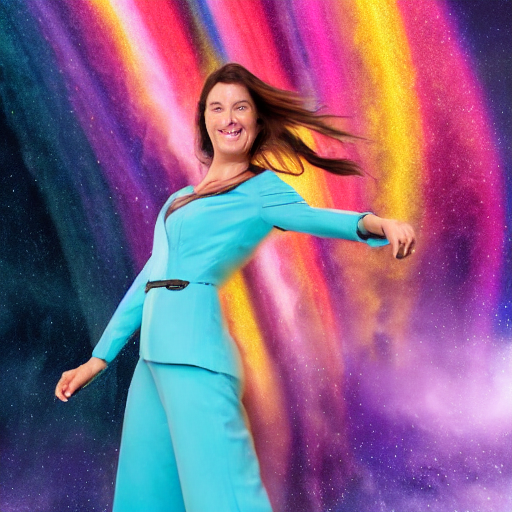

Prompt: a smiling beautiful sorceress wearing a modest high necked blue suit surrounded by swirling rainbow aurora, hyper-realistic, cinematic, post-production
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

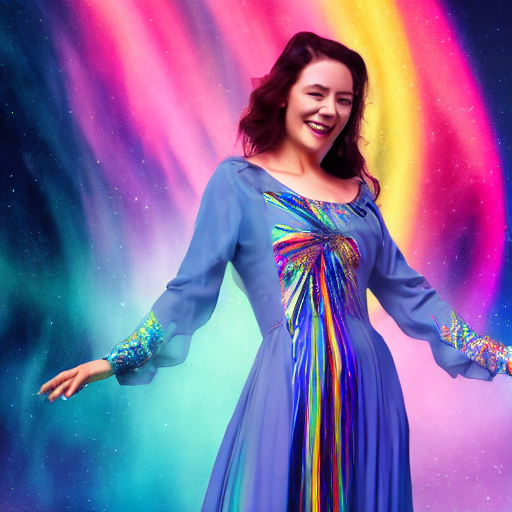

[0.1989564597606659, 0.213086798787117]
Prompt: Anthro humanoid turtle skydiving wearing goggles, gopro footage
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

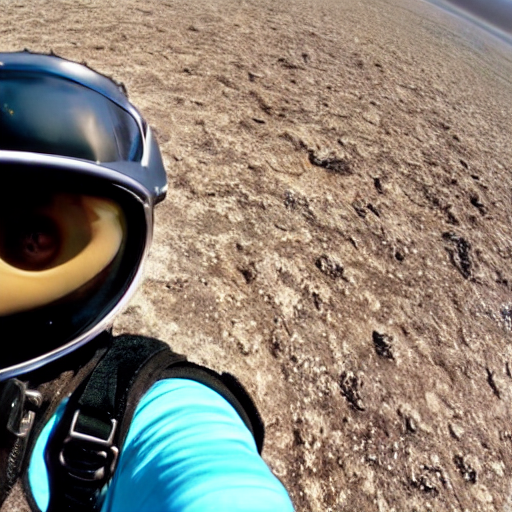

Prompt: Anthro humanoid turtle skydiving wearing goggles, gopro footage
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

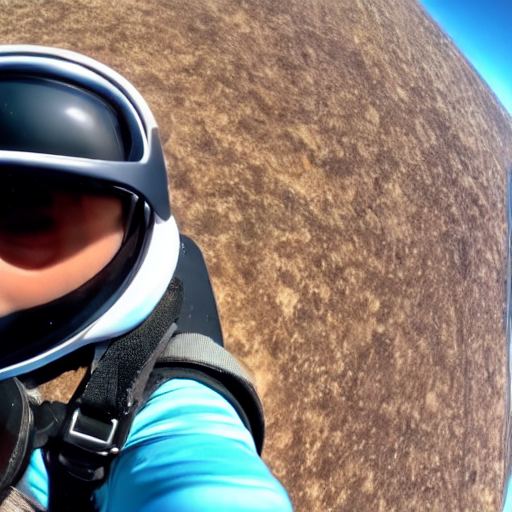

[0.18652504682540894, 0.19019198417663574]
Prompt: A man in a suit surfing in a river
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

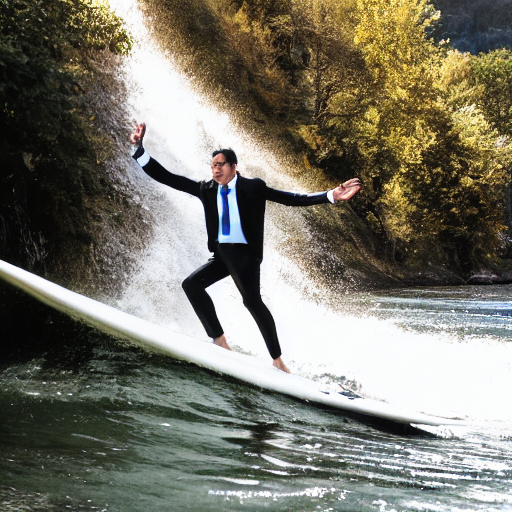

Prompt: A man in a suit surfing in a river
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

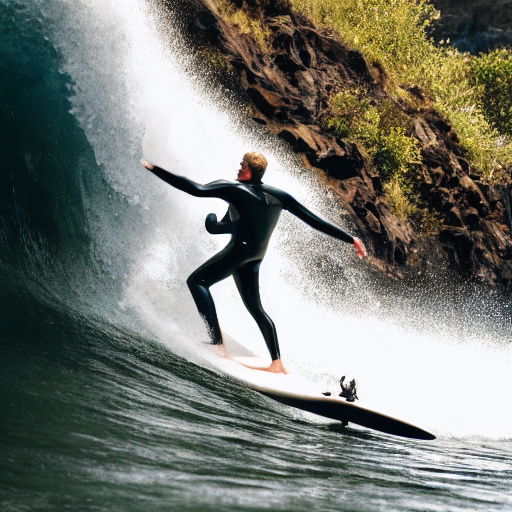

[0.23405103385448456, 0.22364580631256104]
Prompt: photo of a zebra dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

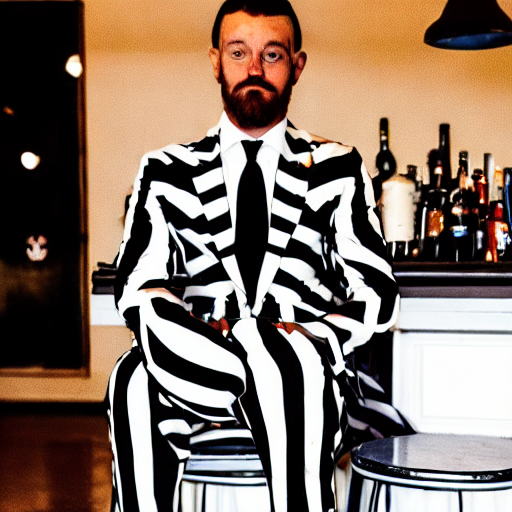

Prompt: photo of a zebra dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

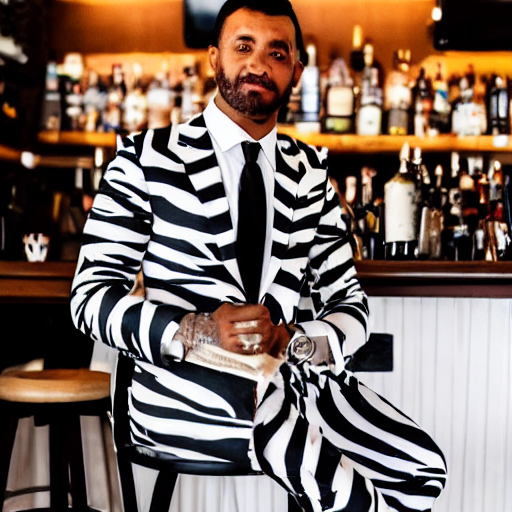

[0.2089643031358719, 0.22374793887138367]
Prompt: A typhoon in a tea cup, digital render
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

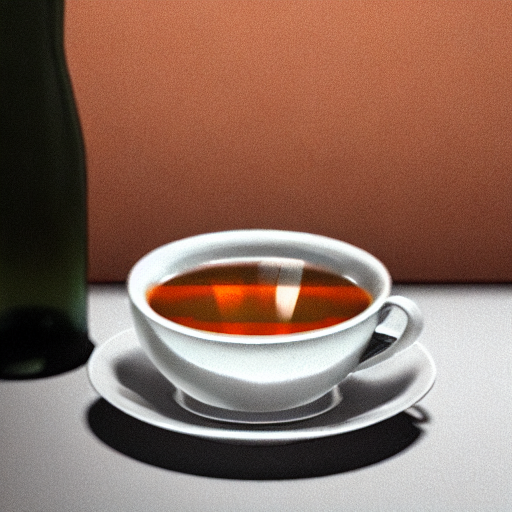

Prompt: A typhoon in a tea cup, digital render
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

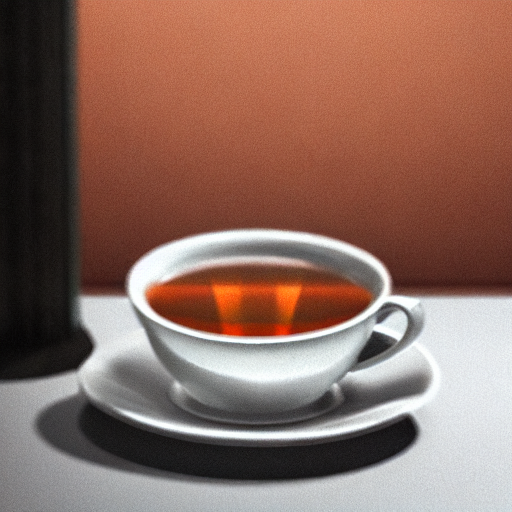

[0.20843134820461273, 0.21218401193618774]
Prompt: A cute puppy leading a session of the United Nations, newspaper photography
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

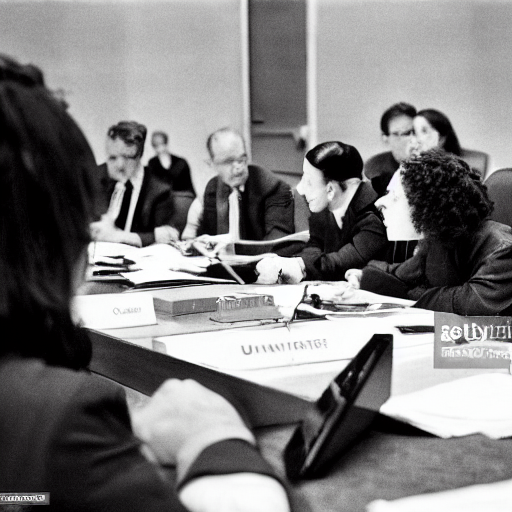

Prompt: A cute puppy leading a session of the United Nations, newspaper photography
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

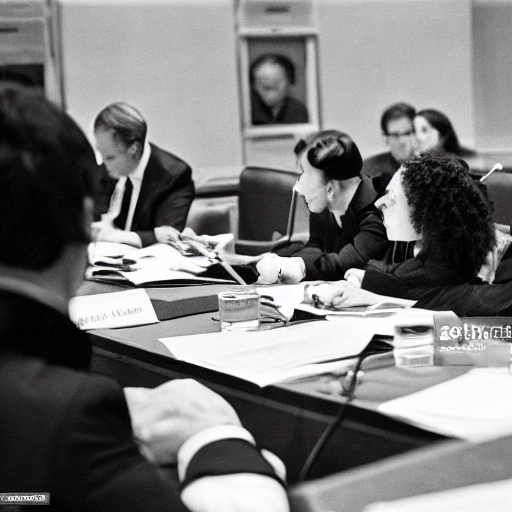

[0.1847844123840332, 0.1888129711151123]
Prompt: Worm eye view of rocketship
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

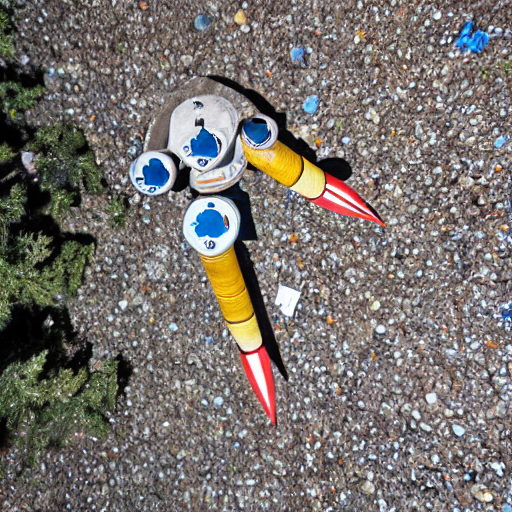

Prompt: Worm eye view of rocketship
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

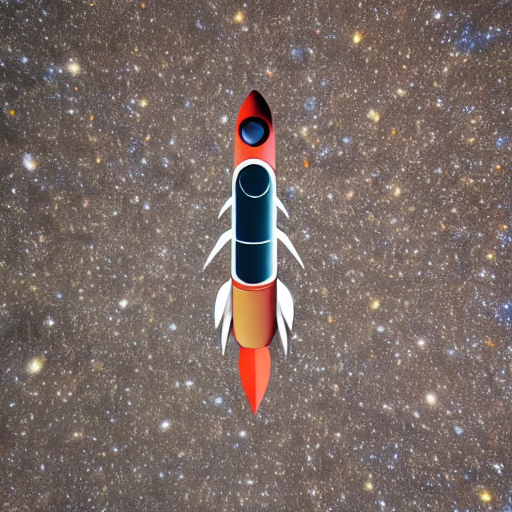

[0.18979252874851227, 0.20478075742721558]
Prompt: Glass spheres in the desert, refraction render
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

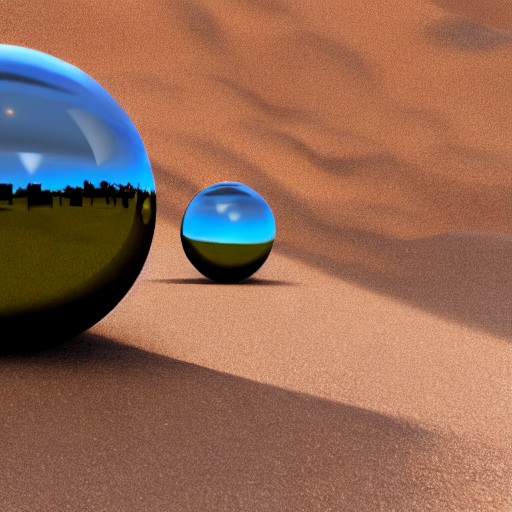

Prompt: Glass spheres in the desert, refraction render
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

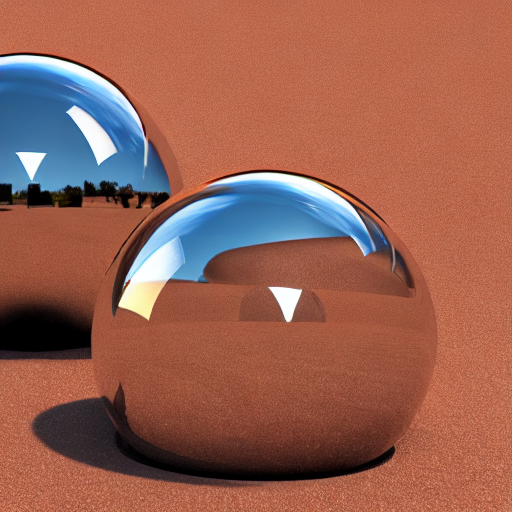

[0.21952275931835175, 0.21595433354377747]
Prompt: anthropmorphic coffee bean drinking coffee
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

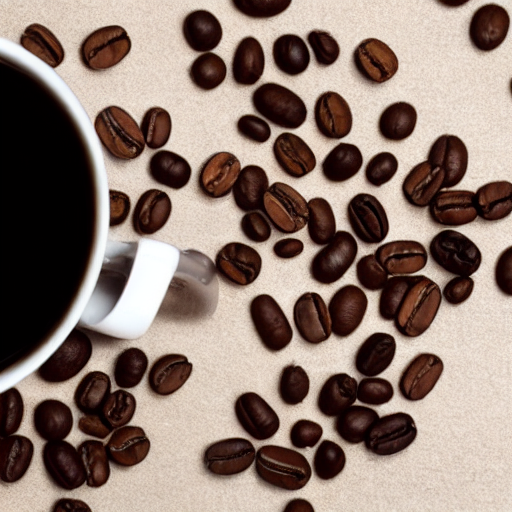

Prompt: anthropmorphic coffee bean drinking coffee
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

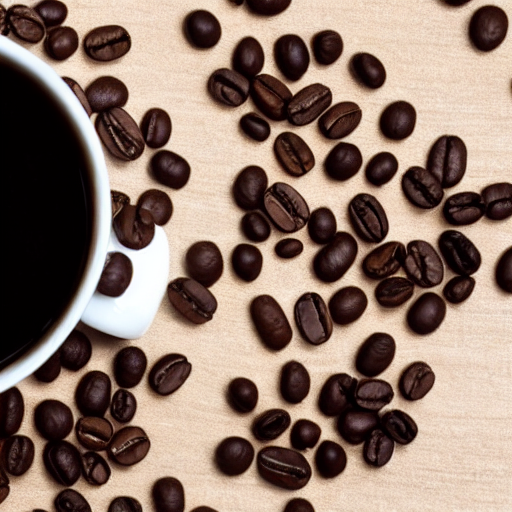

[0.19211015105247498, 0.19155797362327576]
Prompt: A baby kangaroo in a trenchcoat
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

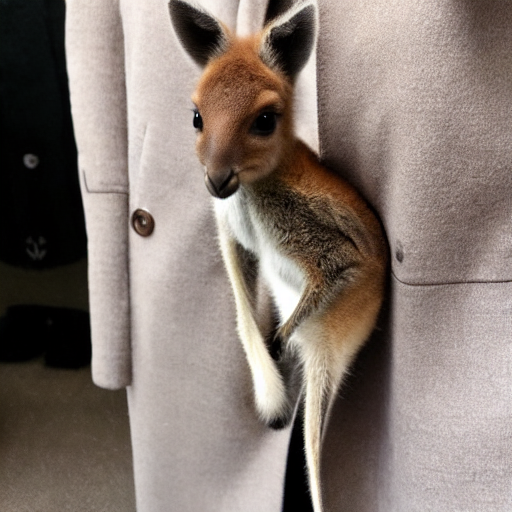

Prompt: A baby kangaroo in a trenchcoat
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

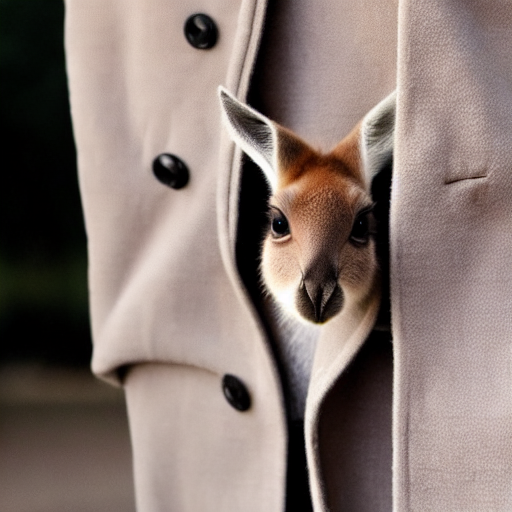

[0.2131476253271103, 0.21504229307174683]
Prompt: A towering hurricane of rainbow colors towering over a city, cinematic digital art
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

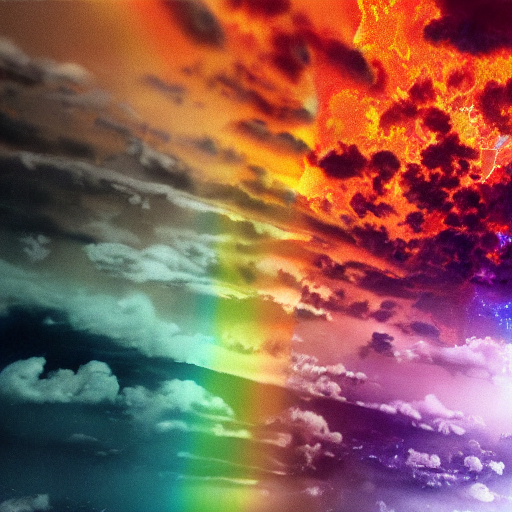

Prompt: A towering hurricane of rainbow colors towering over a city, cinematic digital art
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

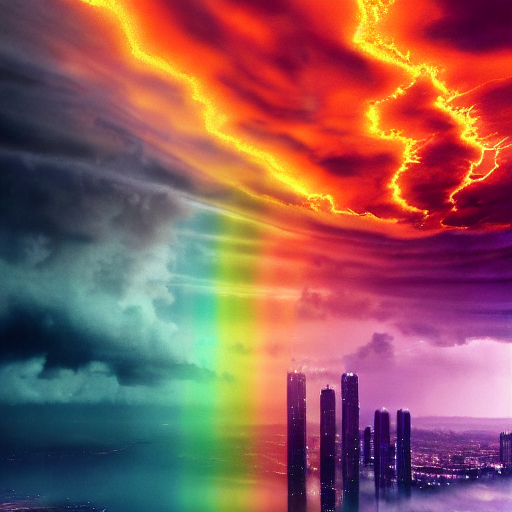

[0.20105931162834167, 0.20944122970104218]
Prompt: A redwood tree rising up out of the ocean
Seed: 0
Orig. SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

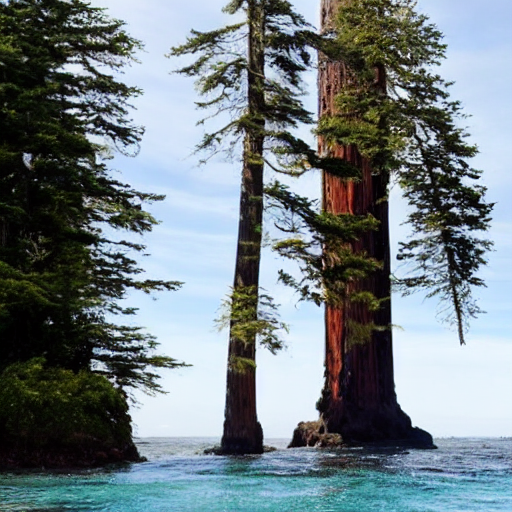

Prompt: A redwood tree rising up out of the ocean
Seed: 0
DPO SDXL


  0%|          | 0/50 [00:00<?, ?it/s]

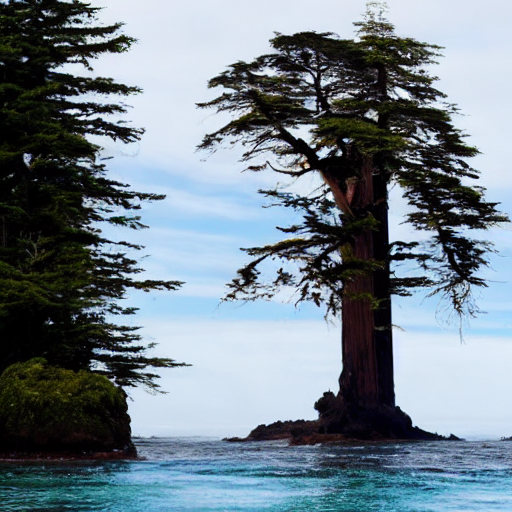

[0.2185482680797577, 0.2235400676727295]


In [ ]:
example_prompts = [
    "A pile of sand swirling in the wind forming the shape of a dancer",
    "A giant dinosaur frozen into a glacier and recently discovered by scientists, cinematic still",
    "a smiling beautiful sorceress with long dark hair and closed eyes wearing a dark top surrounded by glowing fire sparks at night, magical light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production",
    "A purple raven flying over big sur, light fog, deep focus+closeup, hyper-realistic, volumetric lighting, dramatic lighting, beautiful composition, intricate details, instagram, trending, photograph, film grain and noise, 8K, cinematic, post-production",
    "a smiling beautiful sorceress wearing a modest high necked blue suit surrounded by swirling rainbow aurora, hyper-realistic, cinematic, post-production",
    "Anthro humanoid turtle skydiving wearing goggles, gopro footage",
    "A man in a suit surfing in a river",
    "photo of a zebra dressed suit and tie sitting at a table in a bar with a bar stools, award winning photography",
    "A typhoon in a tea cup, digital render",
    "A cute puppy leading a session of the United Nations, newspaper photography",
    "Worm eye view of rocketship",
    "Glass spheres in the desert, refraction render",
    "anthropmorphic coffee bean drinking coffee",
    "A baby kangaroo in a trenchcoat",
    "A towering hurricane of rainbow colors towering over a city, cinematic digital art",
    "A redwood tree rising up out of the ocean",
]


for p in example_prompts:
    ims = gen(p) # could save these if desired    
    scores = ps_selector.score(ims, p)
    print(scores)

In [ ]:
# to get partiprompts captions
from datasets import load_dataset
dataset = load_dataset("nateraw/parti-prompts")
print(dataset['train']['Prompt'])